In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import anndata 
import seaborn as sns
from scipy.stats import zscore
import matplotlib.pyplot as plt
import collections

from sklearn.decomposition import PCA
from umap import UMAP

from matplotlib.colors import LinearSegmentedColormap

from scroutines.config_plots import *
from scroutines import powerplots # .config_plots import *
from scroutines import pnmf
from scroutines import basicu


/home/qlyu/mambaforge/envs/bbbroutine/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
outdir_fig = "/scr/qlyu/projects/v1/figures"

In [3]:
adata = anndata.read("../../data/cheng21_cell_scrna/reorganized/all_L23.h5ad")
genes = adata.var.index.values
conds = adata.obs['cond'].values
types = adata.obs['Type'].values
samps = adata.obs['sample'].values
adata

AnnData object with n_obs × n_vars = 41048 × 53801
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond'

In [4]:
rename = {
    "L2/3_A": "L2/3_A",
    "L2/3_B": "L2/3_B",
    "L2/3_C": "L2/3_C",
    
    "L2/3_1": "L2/3_A",
    "L2/3_2": "L2/3_B",
    "L2/3_3": "L2/3_C",
    
    "L2/3_AB": "L2/3_A",
    "L2/3_BC": "L2/3_C",
}
adata.obs['easitype'] = adata.obs['Type'].apply(lambda x: rename[x])

In [5]:
# use those 286 genes
# df = pd.read_csv("../../data/cheng21_cell_scrna/res/candidate_genes_vincent_0503_v2.csv")
df = pd.read_csv("../../data/cheng21_cell_scrna/res/L23-ABC-genes-n288-n286unq-annot.csv")
genes_sel = df['gene'].astype(str).values
genes_grp = df['P17on'].astype(str).values
assert len(genes_sel) == len(np.unique(genes_sel))

gi = basicu.get_index_from_array(genes, genes_sel)
assert np.all(genes_sel != -1)

# CP10k for single cells
cov = np.array(adata.X.sum(axis=1))
counts = np.array(adata.X[:,gi].todense())
norm = counts/cov*1e4
lognorm = np.log10(norm+1)
zlognorm = zscore(lognorm, axis=0) 

In [6]:
# zlognorm = np.nan_to_num(zlognorm, 0)

In [7]:
gene_types, gene_type_counts = np.unique(genes_grp, return_counts=True)
gene_types, gene_type_counts

(array(['A', 'B', 'C'], dtype=object), array([122,  35, 129]))

In [8]:
pca = PCA(n_components=50)
pcs = pca.fit_transform(zlognorm)

ucs = UMAP(n_components=2, n_neighbors=50).fit_transform(pcs)

In [9]:
# # fix pc1 to make sure a < c:
# pc1 = pcs[:,0]
# pc_types, unq_types = basicu.group_mean(pc1.reshape(-1,1), types)
# a = pc_types[0,0]
# c = pc_types[-1,0]
# if a > c:
#     pcs[:,0] = -pcs[:,0]

In [10]:
res = pd.DataFrame(pcs, columns=np.char.add("PC", ((1+np.arange(pcs.shape[1])).astype(str))))
res['cond'] = conds
res['type'] = types
res['samp'] = samps
res['umap1'] = ucs[:,0]
res['umap2'] = ucs[:,1]
# res['type'] = types

Text(0, 0.5, 'explained var')

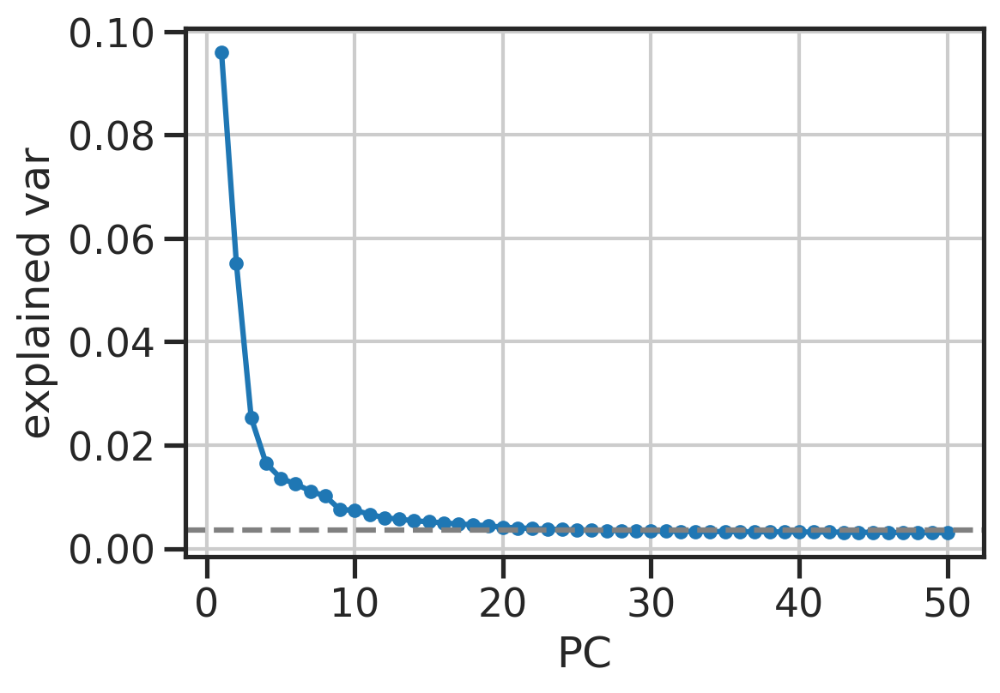

In [11]:
# plt.plot(np.cumsum(pca.explained_variance_ratio_), '-o')
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(np.arange(len(pca.explained_variance_ratio_))+1, pca.explained_variance_ratio_, '-o', markersize=5)
ax.axhline(1/lognorm.shape[1], linestyle='--', color='gray')
ax.set_xlabel('PC')
ax.set_ylabel('explained var')

In [12]:
allcolors = sns.color_palette('tab20c', 20)
allcolors

[(0.19215686274509805, 0.5098039215686274, 0.7411764705882353),
 (0.4196078431372549, 0.6823529411764706, 0.8392156862745098),
 (0.6196078431372549, 0.792156862745098, 0.8823529411764706),
 (0.7764705882352941, 0.8588235294117647, 0.9372549019607843),
 (0.9019607843137255, 0.3333333333333333, 0.050980392156862744),
 (0.9921568627450981, 0.5529411764705883, 0.23529411764705882),
 (0.9921568627450981, 0.6823529411764706, 0.4196078431372549),
 (0.9921568627450981, 0.8156862745098039, 0.6352941176470588),
 (0.19215686274509805, 0.6392156862745098, 0.32941176470588235),
 (0.4549019607843137, 0.7686274509803922, 0.4627450980392157),
 (0.6313725490196078, 0.8509803921568627, 0.6078431372549019),
 (0.7803921568627451, 0.9137254901960784, 0.7529411764705882),
 (0.4588235294117647, 0.4196078431372549, 0.6941176470588235),
 (0.6196078431372549, 0.6039215686274509, 0.7843137254901961),
 (0.7372549019607844, 0.7411764705882353, 0.8627450980392157),
 (0.8549019607843137, 0.8549019607843137, 0.9215686274509803),
 (0.38823529411764707, 0.38823529411764707, 0.38823529411764707),
 (0.5882352941176471, 0.5882352941176471, 0.5882352941176471),
 (0.7411764705882353, 0.7411764705882353, 0.7411764705882353),
 (0.8509803921568627, 0.8509803921568627, 0.8509803921568627)]

In [13]:
allcolors2 = sns.color_palette('tab10', 20)
allcolors2

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
 (0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [14]:
palette = collections.OrderedDict({
     "P8NR": allcolors[2],
    "P14NR": allcolors[0],
    
    "P17NR": allcolors[7],
    "P21NR": allcolors[6],
    "P28NR": allcolors[5],
    "P38NR": allcolors[4],
    
    "P28DL": allcolors[8],
    
    "P28DR": allcolors[14],
    "P38DR": allcolors[12],
})

cases = np.array(list(palette.keys()))
cases

array(['P8NR', 'P14NR', 'P17NR', 'P21NR', 'P28NR', 'P38NR', 'P28DL',
       'P28DR', 'P38DR'], dtype='<U5')

In [15]:
palette_types = collections.OrderedDict({
    'L2/3_A': allcolors2[0],
    'L2/3_B': allcolors2[1],
    'L2/3_C': allcolors2[2],
    
    'L2/3_1': allcolors2[0],
    'L2/3_2': allcolors2[1],
    'L2/3_3': allcolors2[2],
    
    'L2/3_AB': allcolors2[0],
    'L2/3_BC': allcolors2[2],
})             

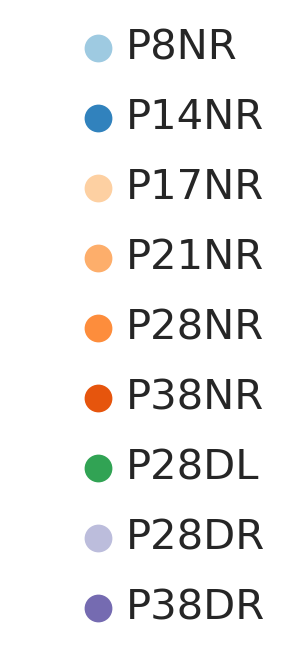

In [16]:
fig, ax = plt.subplots(figsize=(1,4))
for i, (key, item) in enumerate(palette.items()):
    ax.plot(0,     len(palette)-i, 'o', c=item, )
    ax.text(0.02,  len(palette)-i, key, va='center', fontsize=15)
    ax.axis('off')
plt.show()

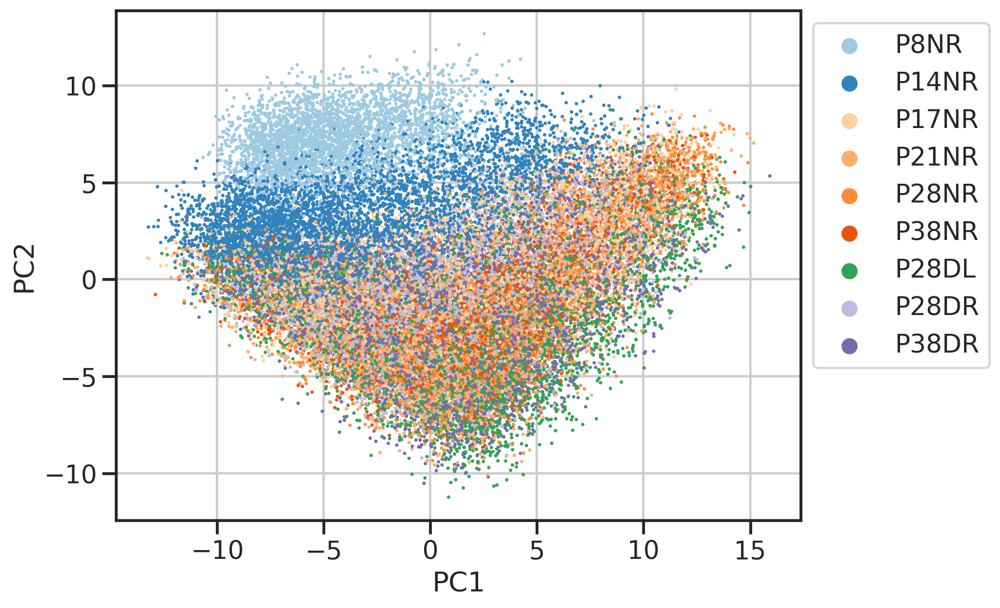

In [17]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC1', y='PC2', 
                hue='cond',
                hue_order=list(palette.keys()),
                palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

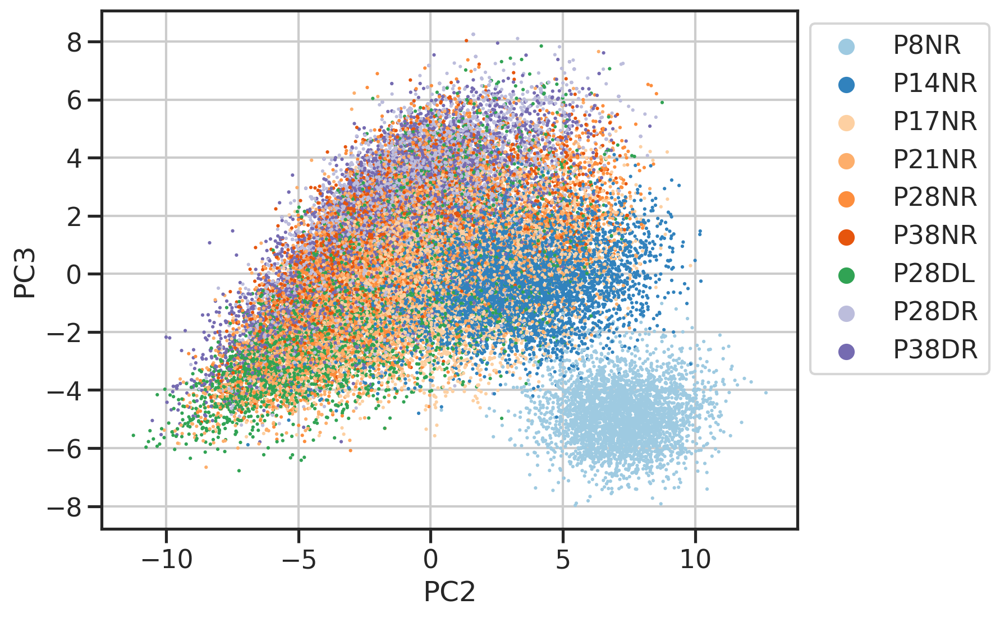

In [18]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC2', y='PC3', 
                hue='cond',
                hue_order=list(palette.keys()),
                palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

In [19]:
def plot_n1(x, y, hue, palette):
    """
    """
    fig, ax = plt.subplots(1,1,figsize=(8*1,6))
    sns.scatterplot(data=res.sample(frac=1, replace=False), 
                    x=x, y=y, 
                    hue=hue,
                    hue_order=list(palette.keys()),
                    palette=palette,
                    s=5, edgecolor='none', 
                    # legend=False,
                    ax=ax,
                   )
    ax.legend(bbox_to_anchor=(1,1))
    plt.show()
    
def plot_n9(x, y, hue, palette=None):
    """
    """
    fig, axs = plt.subplots(3,3,figsize=(4*3,4*3), sharex=True, sharey=True)
    for ax, cond in zip(axs.flat, cases):
        ax.set_title(cond)
        sns.scatterplot(data=res, 
                        x=x, y=y, 
                        c='lightgray',
                        s=1, edgecolor='none', 
                        legend=False,
                        ax=ax,
                       )
        sns.scatterplot(data=res[res['cond']==cond].sample(frac=1, replace=False),
                        x=x, y=y, 
                        hue=hue,
                        hue_order=list(palette.keys()),
                        palette=palette,
                        s=3, edgecolor='none', 
                        legend=False,
                        ax=ax,
                       )
        sns.despine(ax=ax)
    plt.show()

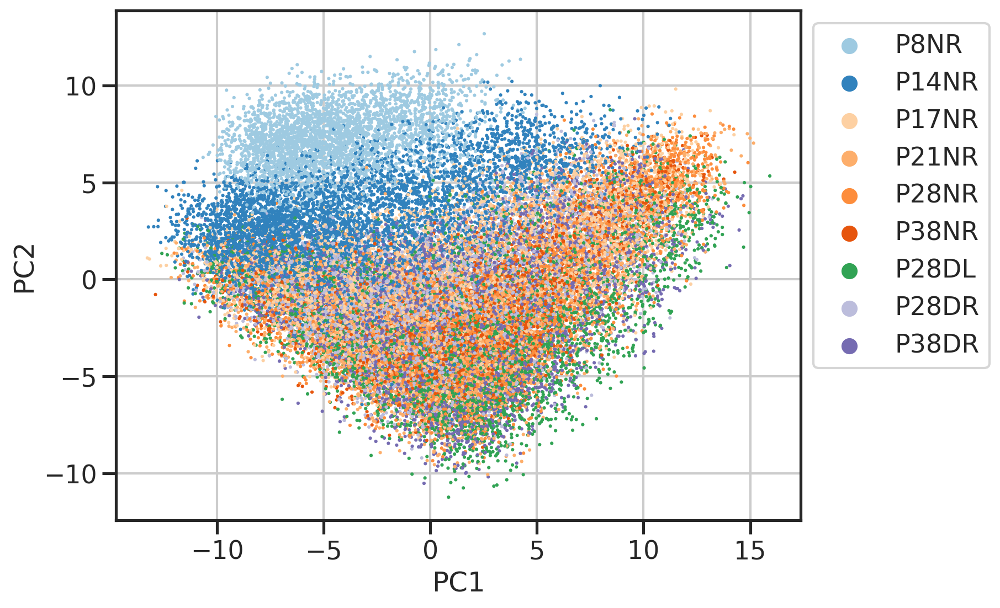

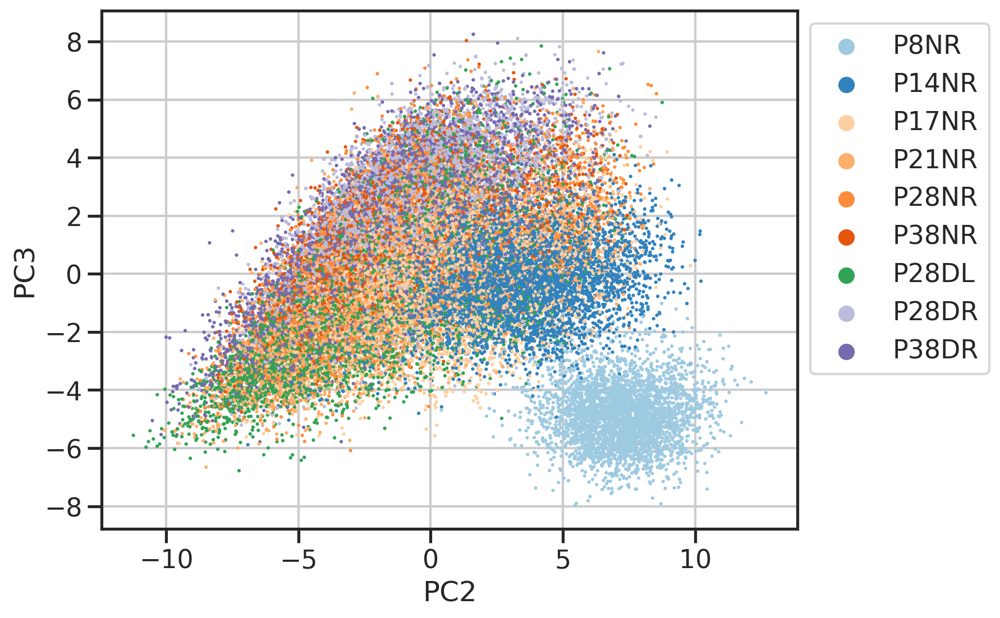

In [20]:
plot_n1('PC1', 'PC2', 'cond', palette)
plot_n1('PC2', 'PC3', 'cond', palette)

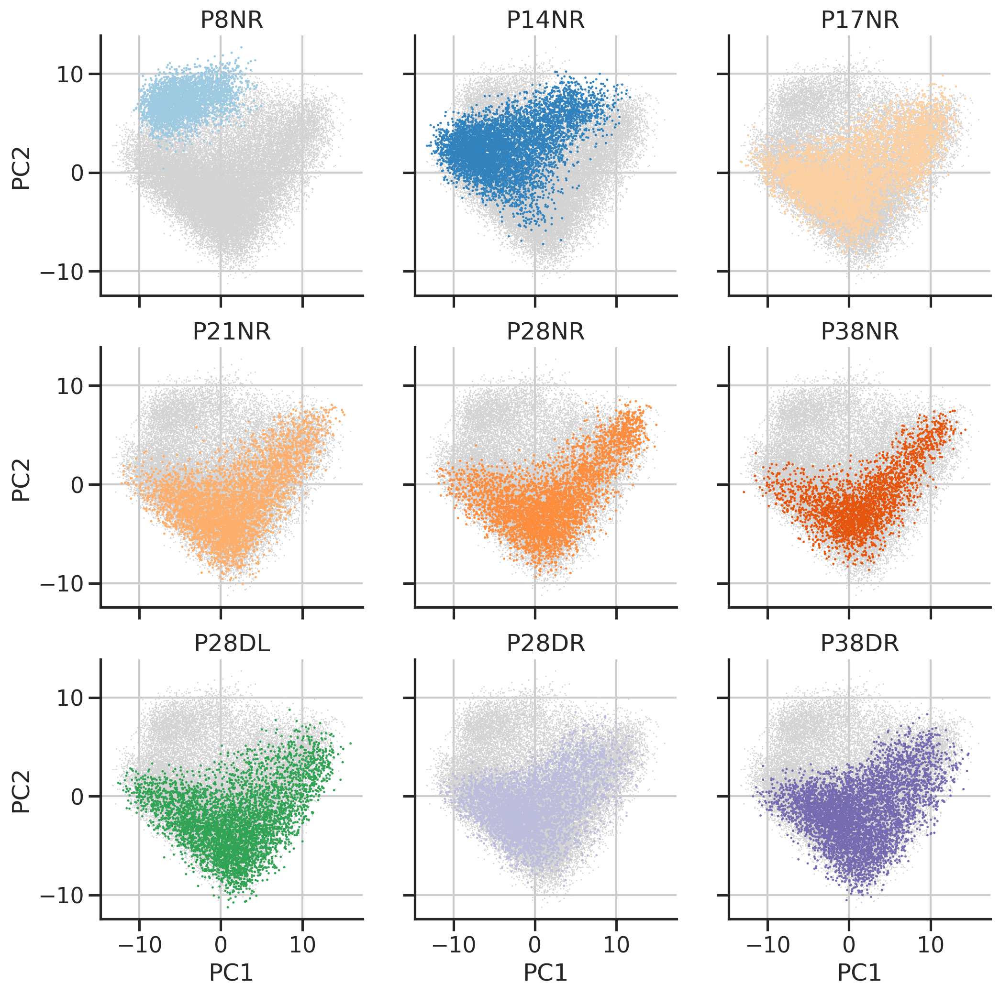

In [21]:
plot_n9('PC1', 'PC2', 'cond', palette)

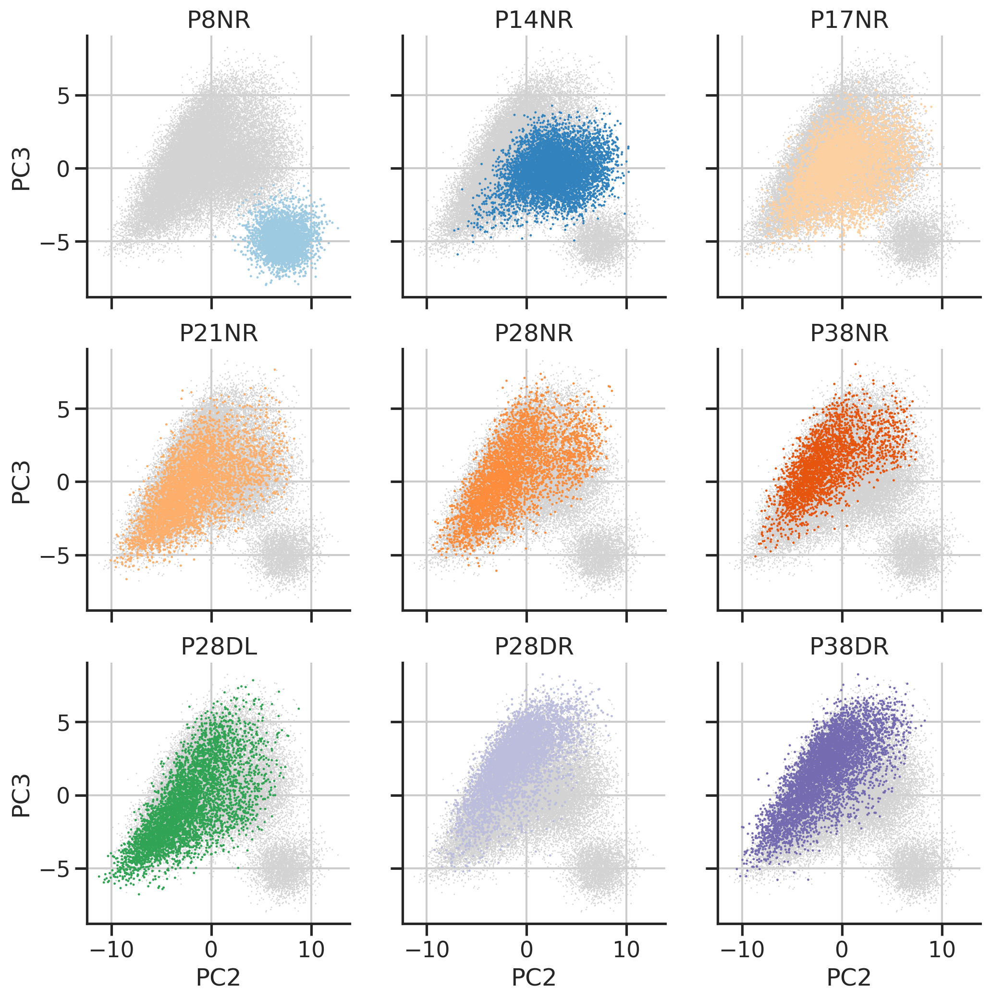

In [22]:
plot_n9('PC2', 'PC3', 'cond', palette)

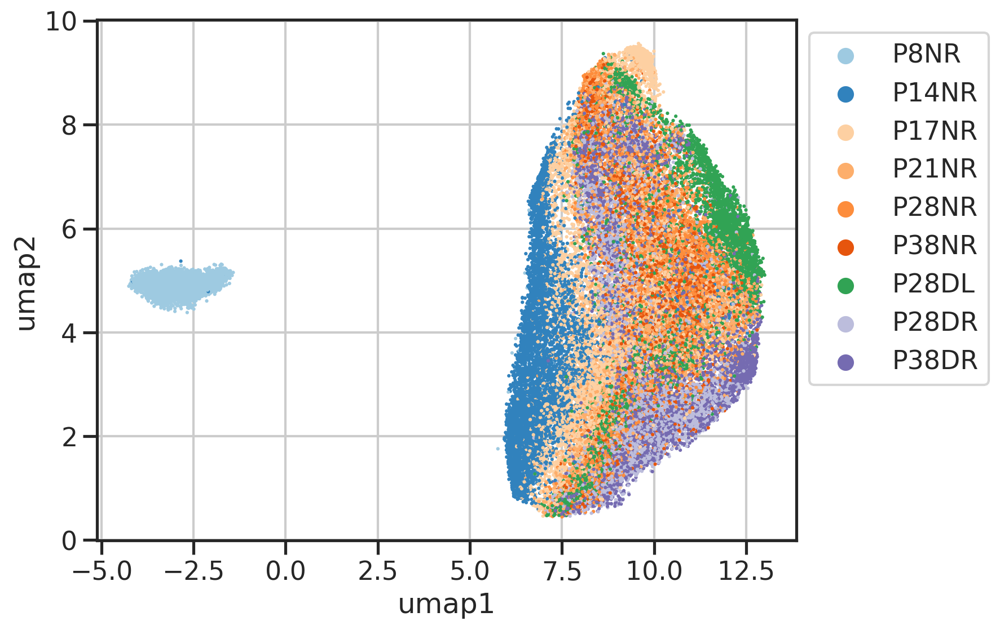

In [23]:
plot_n1('umap1', 'umap2', 'cond', palette)

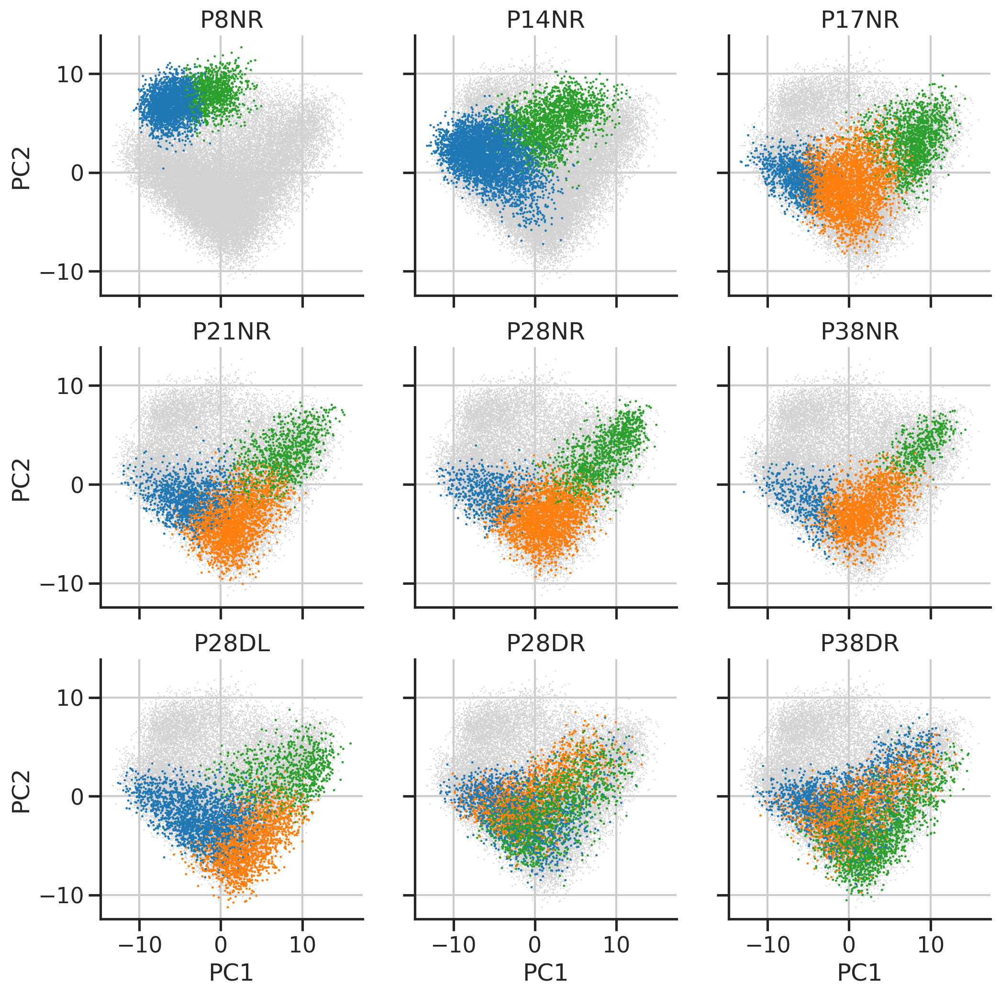

In [24]:
plot_n9('PC1', 'PC2', 'type', palette_types)

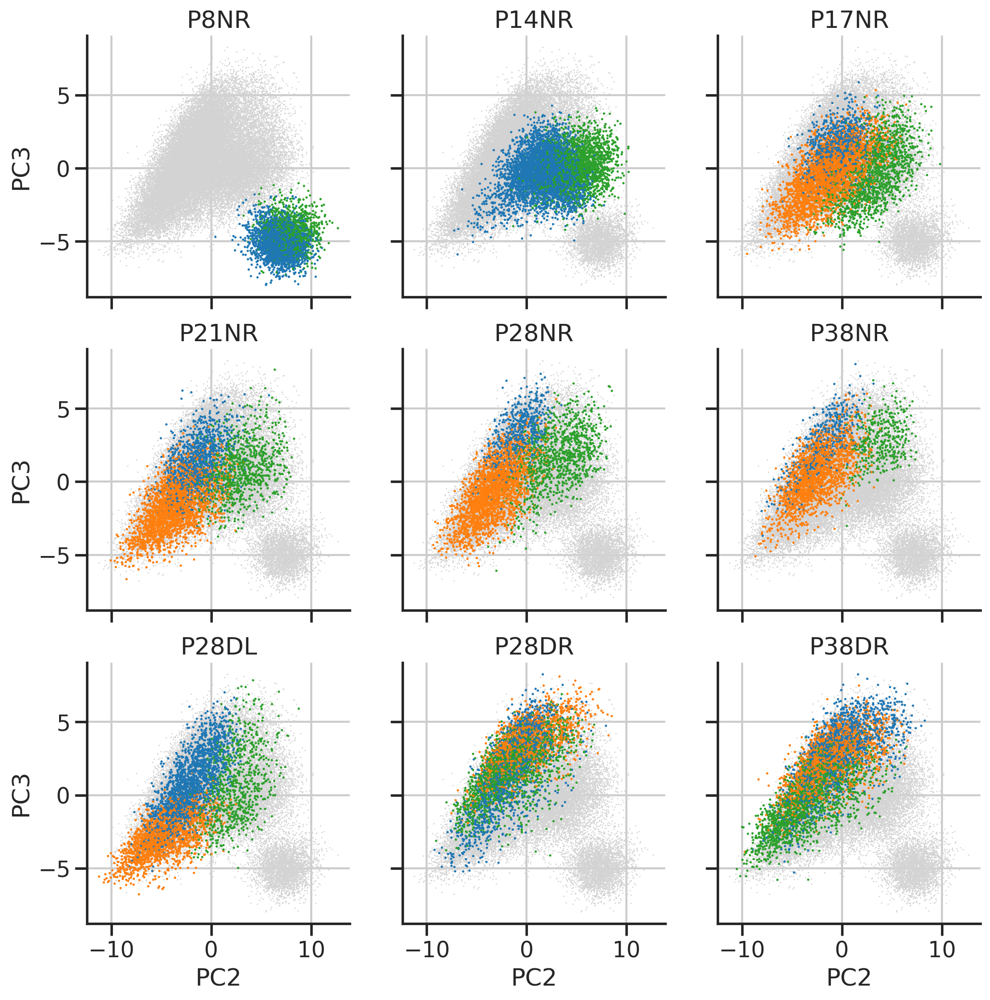

In [25]:
plot_n9('PC2', 'PC3', 'type', palette_types)

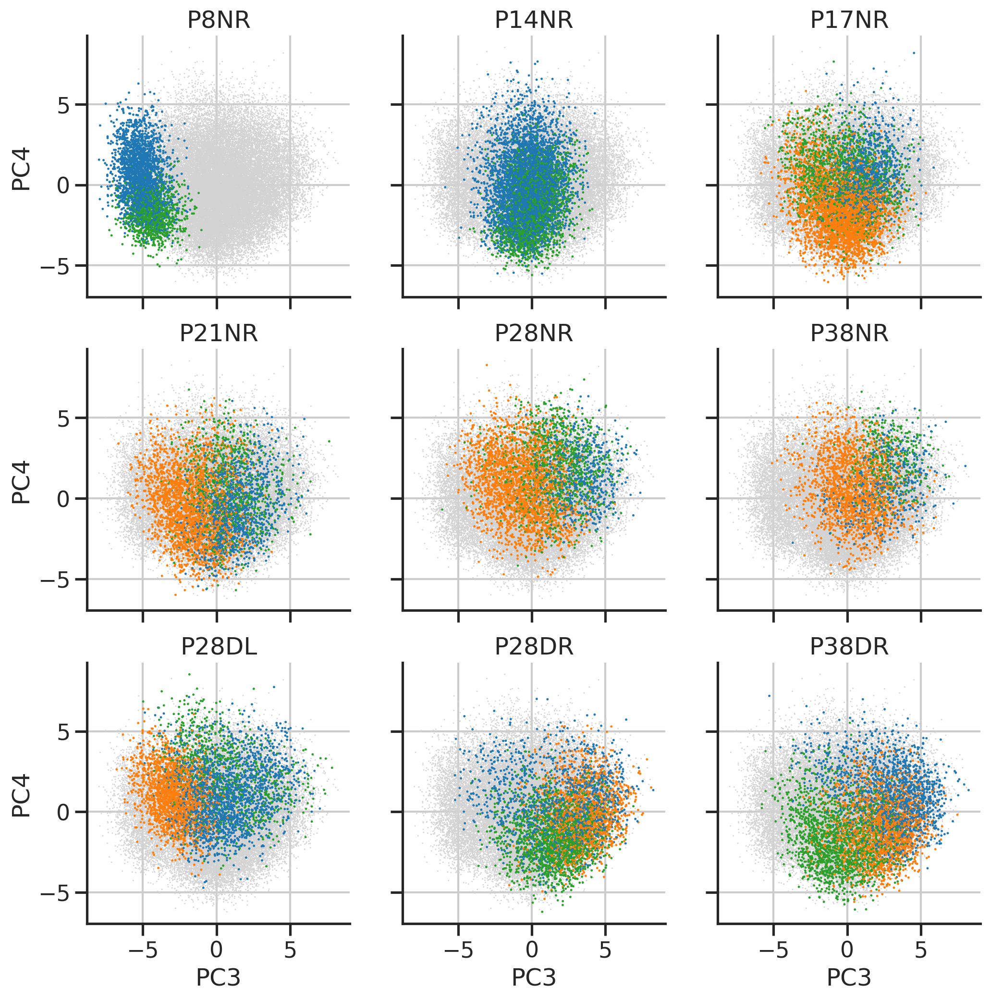

In [26]:
plot_n9('PC3', 'PC4', 'type', palette_types)

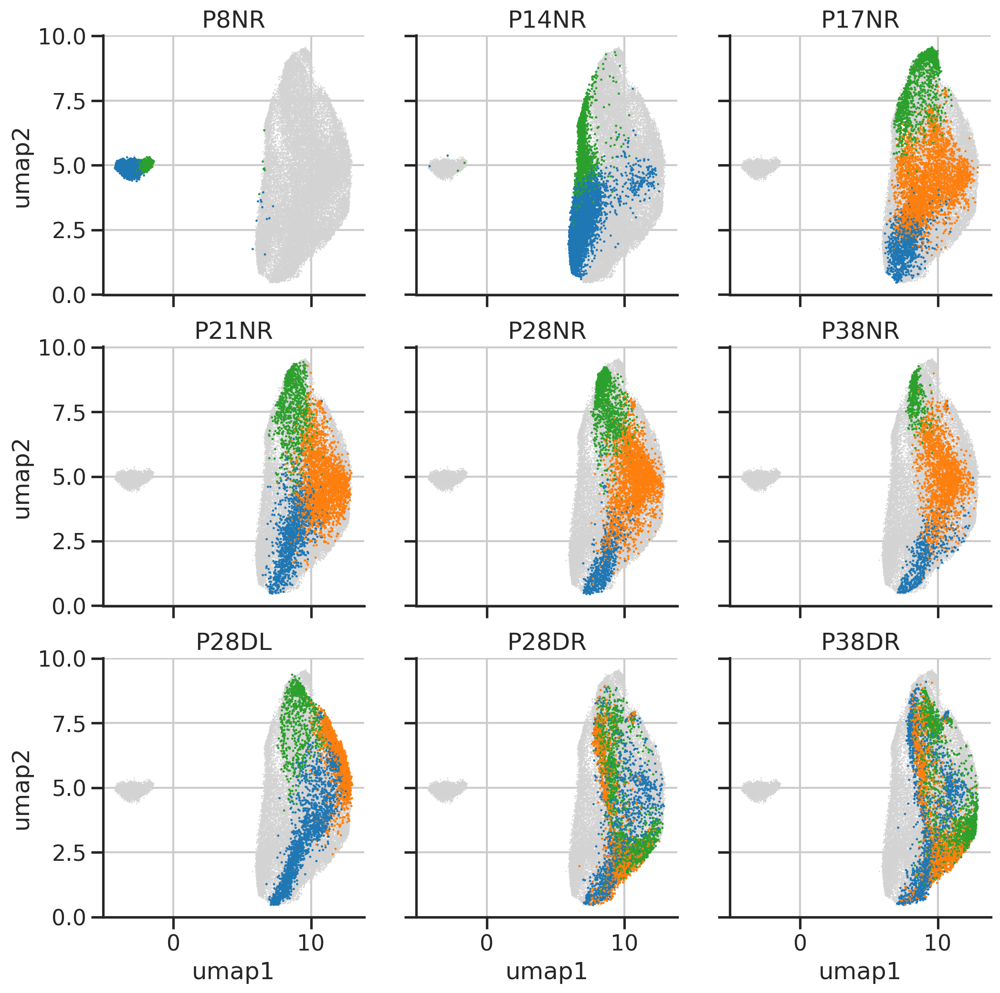

In [27]:
plot_n9('umap1', 'umap2', 'type', palette_types)

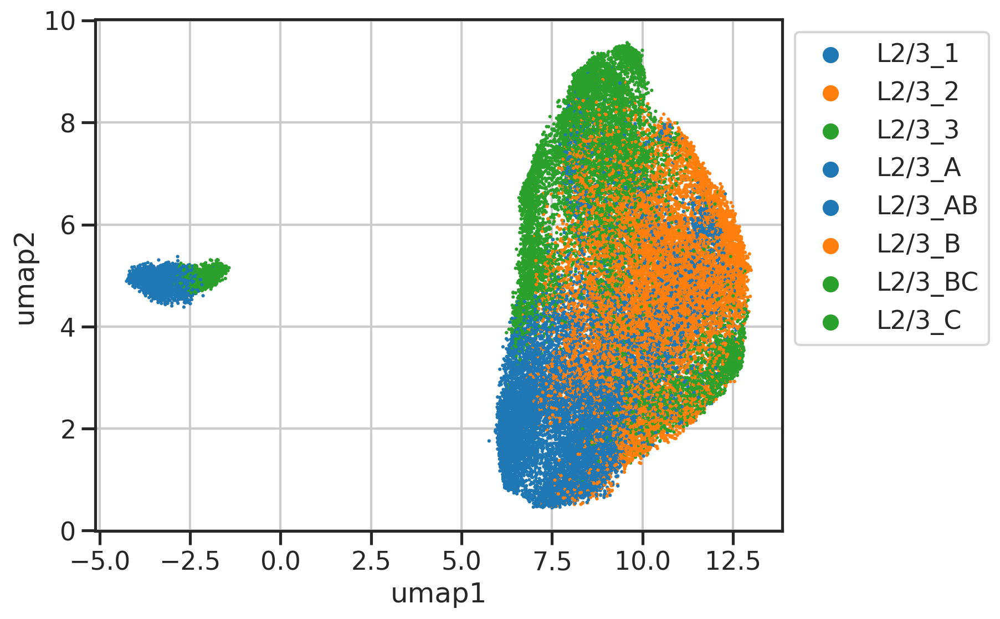

In [28]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='type',
                # hue='cond',
                # hue_order=list(palette.keys()),
                palette=palette_types,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

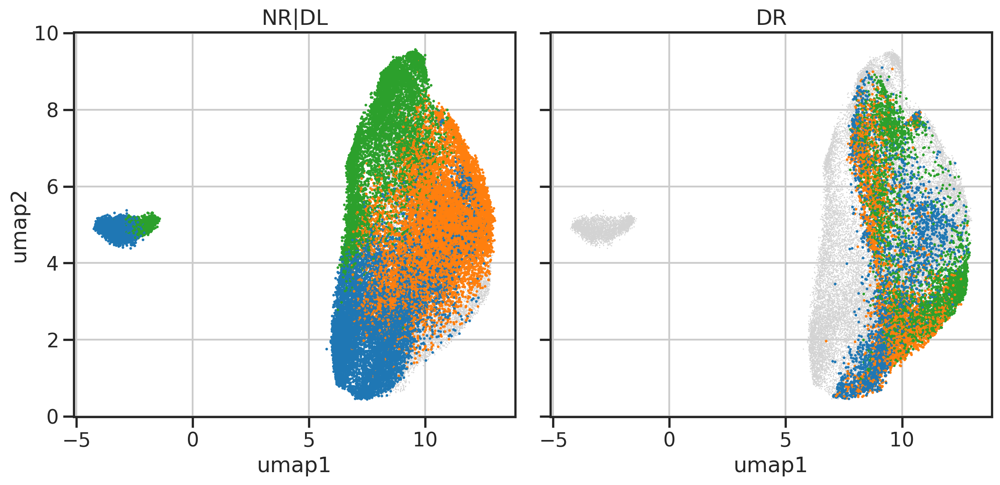

In [29]:
fig, axs = plt.subplots(1,2,figsize=(6*2,6), sharex=True, sharey=True)
categories = ['NR|DL', 'DR']
for cat, ax in zip(categories, axs.flat):
    ax.set_title(cat)
    sns.scatterplot(data=res, #[res['cond'].str.contains('DR')].sample(frac=1, replace=False), 
                    x='umap1', y='umap2', 
                    color='lightgray',
                    s=1, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.scatterplot(data=res[res['cond'].str.contains(cat)].sample(frac=1, replace=False), 
                    x='umap1', y='umap2', 
                    hue='type',
                    palette=palette_types,
                    s=5, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
# ax.legend(bbox_to_anchor=(1,1))
fig.tight_layout()
plt.show()

In [30]:
adata

AnnData object with n_obs × n_vars = 41048 × 53801
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'easitype'

In [31]:
adatasub = adata[:,gi].copy()
adatasub.layers['log10CP10k'] = lognorm
adatasub.layers['zlog10CP10k'] = zlognorm
adatasub.obsm['X_pca'] = pcs
adatasub.obs['umap1'] = res['umap1']
adatasub.obs['umap2'] = res['umap2']
adatasub

AnnData object with n_obs × n_vars = 41048 × 286
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'easitype', 'umap1', 'umap2'
    obsm: 'X_pca'
    layers: 'log10CP10k', 'zlog10CP10k'

In [33]:
fout = "/scr/qlyu/projects/v1/data/cheng21_cell_scrna/reorganized/allL23_typegenes_Mar29.h5ad" 
adatasub.write(fout)